In [1]:
cd ../../..

/home/msi/projects/diplomka


In [2]:
import scipy.stats as st
from pprint import pprint

import glob
import os 
import numpy as np
import pandas as pd
from tqdm import tqdm

from scipy.stats import hmean
from collections import defaultdict

from traced.trace_monitor import SiteTraceMonitor
from traced.models import NormalModel

import matplotlib.pyplot as plt 

In [3]:
dataset = os.listdir('data/sites/')[4]
dataset

'CA_SFU_T2-CSCS_LCG2'

In [4]:
files = sorted(glob.glob(f"data/sites/{dataset}/*"))

In [5]:
src_site, dest_site = dataset.split('-')

In [6]:
stm = SiteTraceMonitor(src_site, dest_site)

In [7]:
stm.process(files)

100%|██████████| 44635/44635 [00:40<00:00, 1108.11it/s]


In [8]:
ip_pair = 1

In [9]:
data = stm.trace_models[
    list(stm.trace_models.keys())[ip_pair]
  ].detected

## Parse from temporary container to dataframe

In [10]:
df = pd.DataFrame.from_dict(data).T
df['ts'] = pd.to_datetime(df['ts'], unit='ms')
df.set_index('ts', inplace=True)
df['n_hops_prob'] = df['n_hops'].apply(lambda x: x[1])
df['n_hops_expected'] = df['n_hops'].apply(lambda x: x[2])
df['n_hops_observed'] = df['n_hops'].apply(lambda x: x[3])
df['ip_probs'] = df['ip'].apply(lambda x: x[1])
df['asn_probs'] = df['asn'].apply(lambda x: x[1])
df['path_prob'] = df['path'].apply(lambda x : x[1])
df['reached'] = df['reached'].apply(lambda x: x[1])
df['rtt_anoms'] = df['rtts'].apply(lambda x: x[0])
df['rtt_n_anoms'] = df['rtts'].apply(lambda x: x[1])
df['rtt_z_scores'] = df['rtts'].apply(lambda x: x[2])
df['rtt_expected'] = df['rtts'].apply(lambda x: x[3])
df['rtt_observed'] = df['rtts'].apply(lambda x: x[4])
df['rtt_sigma'] = df['rtts'].apply(lambda x: x[5])
df['ttl_anoms'] = df['ttls'].apply(lambda x: x[0])
df['ttl_probs'] = df['ttls'].apply(lambda x: x[1])
df['ttl_expected'] = df['ttls'].apply(lambda x: x[2])
df['ttl_observed'] = df['ttls'].apply(lambda x: x[3])
df['ttl_n_anoms'] = df['ttls'].apply(lambda x: x[4])
df.drop(columns=['has_anomaly', 'anom_share', 'ttls', 'rtts', 'path','n_hops', 'ip', 'asn'], inplace=True)

## Outlier sequence weights

The goal of the model averaging is to combine the infromation obtained from a set of models. Usually either the predictions, or the parameters of the model are combined. 

Some of the most common methods are:

- normal averaging
    - values are averages using $\frac{1}{N}\sum^N_{i=0}{x_i}=\sum^N_{i=0}{\frac{1}{N} \cdot x_i}$
    - we can interpret this as each model being equally important
    

- weighted averaging
    - we assign weights for each model in order to scale its influence  $\sum^N_{i=0}{w_i x_i}$
    - I use normalized weights, in order to reduce bias and smooth out the result

- estimate weights with another model
    - we can use another model to train the weights, however this is mostly used fro supervised learning
    


I decided to take try the normal and weighted averaging approach and try to find a way to automatically weight the models.

I tried to come up with few different types of weights based on the number of outliers and information of the current outlier state in the record.


For example, for some theoretical traceroute, let's say that the we have these values:

<center>
<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>X</th>
      <th>E</th>
      <th>X-E</th>
      <th>X/E</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>0</th>
      <td>7.37</td>
      <td>6.52</td>
      <td>0.85</td>
      <td>1.13</td>
    </tr>
    <tr>
      <th>1</th>
      <td>1.28</td>
      <td>4.22</td>
      <td>-2.94</td>
      <td>0.30</td>
    </tr>
    <tr>
      <th>2</th>
      <td>10.98</td>
      <td>2.72</td>
      <td>8.26</td>
      <td>4.03</td>
    </tr>
    <tr>
      <th>3</th>
      <td>2.57</td>
      <td>7.96</td>
      <td>-5.39</td>
      <td>0.32</td>
    </tr>
    <tr>
      <th>4</th>
      <td>6.29</td>
      <td>1.74</td>
      <td>4.55</td>
      <td>3.61</td>
    </tr>
  </tbody>
</table>
</center>

Where:
- X represents the RTT
- E is the expected RTT
- X-E is the error of prediction
- X/E is the ratio of the current meassurement to the expected one

After some testing I decided to use the ratio value for as it had some nice attributes.
For example the value in an ideal case would be a constant (1), and if you compare error and this rate meassure (for first and third row), you can see that the error was rather different, but since the rate is proportional to the expected value, we can see that both of them are roughly 0.7 times better than expected.


### Outlier sequences

The first thing I tried to achieve was to be able to reduce the redundant information in the meassurement by gradually decreasing the weights of values that are in a sequence of models that are alerting for an outlier.

So I extract all subsequences based on detected outiers and then assign the first one with the value equal to the length of the sequence, and for each subsequent index, the value is reduced by 1. The rest of them are assigned with weight 1 and the weights are then normalized. 


For example:

<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>is anomaly</th>
      <th>sequence_id</th>
      <th>sequence weigth</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>0</th>
      <td>False</td>
      <td>0</td>
      <td>1</td>
    </tr>
    <tr>
      <th>1</th>
      <td>True</td>
      <td>1</td>
      <td>2</td>
    </tr>
    <tr>
      <th>2</th>
      <td>True</td>
      <td>1</td>
      <td>1</td>
    </tr>
    <tr>
      <th>3</th>
      <td>False</td>
      <td>0</td>
      <td>1</td>
    </tr>
    <tr>
      <th>4</th>
      <td>True</td>
      <td>2</td>
      <td>2</td>
    </tr>
    <tr>
      <th>5</th>
      <td>True</td>
      <td>2</td>
      <td>1</td>
    </tr>
    <tr>
      <th>6</th>
      <td>False</td>
      <td>0</td>
      <td>1</td>
    </tr>
    <tr>
      <th>7</th>
      <td>True</td>
      <td>3</td>
      <td>3</td>
    </tr>
    <tr>
      <th>8</th>
      <td>True</td>
      <td>3</td>
      <td>2</td>
    </tr>
    <tr>
      <th>9</th>
      <td>True</td>
      <td>3</td>
      <td>1</td>
    </tr>
  </tbody>
</table>

## Equalizing the anomality

Another goal for me was to incorporate the number of anomalies measured for some router, but in some cases, when there are routers on which we detect a lot of anomalies, they would end up with weight far greater compared to devices who are almost non-anomalous.

Hence I decided to use the logarithm of the number of outliers observed over time for each of the router currently processed:

<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>anomalies</th>
      <th>weight</th>
      <th>log_anomalies</th>
      <th>weight_log</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>0</th>
      <td>504.0</td>
      <td>0.096092</td>
      <td>6.222576</td>
      <td>0.107282</td>
    </tr>
    <tr>
      <th>1</th>
      <td>4.0</td>
      <td>0.000763</td>
      <td>1.386294</td>
      <td>0.023901</td>
    </tr>
    <tr>
      <th>2</th>
      <td>391.0</td>
      <td>0.074547</td>
      <td>5.968708</td>
      <td>0.102905</td>
    </tr>
    <tr>
      <th>3</th>
      <td>867.0</td>
      <td>0.165300</td>
      <td>6.765039</td>
      <td>0.116635</td>
    </tr>
    <tr>
      <th>4</th>
      <td>224.0</td>
      <td>0.042707</td>
      <td>5.411646</td>
      <td>0.093301</td>
    </tr>
    <tr>
      <th>5</th>
      <td>764.0</td>
      <td>0.145663</td>
      <td>6.638568</td>
      <td>0.114454</td>
    </tr>
    <tr>
      <th>6</th>
      <td>460.0</td>
      <td>0.087703</td>
      <td>6.131226</td>
      <td>0.105707</td>
    </tr>
    <tr>
      <th>7</th>
      <td>600.0</td>
      <td>0.114395</td>
      <td>6.396930</td>
      <td>0.110288</td>
    </tr>
    <tr>
      <th>8</th>
      <td>895.0</td>
      <td>0.170639</td>
      <td>6.796824</td>
      <td>0.117183</td>
    </tr>
    <tr>
      <th>9</th>
      <td>536.0</td>
      <td>0.102193</td>
      <td>6.284134</td>
      <td>0.108344</td>
    </tr>
  </tbody>
</table>

## Mixing the weights

I also decided to try and mix all of the previously mentioned weight vectors.

I calculated their average and the harmonic mean.

In [11]:
def extract_sequences(indexes):
    '''Extracts sequences of consecutive indexes from a list of indexes.'''
    seq = []
    curr = indexes[0]
    tmp = [curr]
    for i in indexes[1:]:
        if i == curr + 1:
            tmp.append(i)
        else:
            seq.append(tmp)
            tmp = [i]
        curr = i
    if tmp:
        seq.append(tmp)
    return seq

In [12]:
def calculate_seq_weights(anoms):
    '''Calculates weights for each anomaly based on the length of the sequence of anomalies it belongs to.'''
    indexes = np.where(anoms)[0]
    if len(indexes) == 0:
        return np.ones(anoms.shape[0])
    seq = extract_sequences(indexes)
    final = np.ones(anoms.shape[0])
    for s in seq:
        l = len(s) 
        for i in s:
            final[i] += l
            l-=1
    return final 

In [13]:
def calculate_error_rate(E, X):
    values = [ ]
    for mu, x in zip(E, X):
        values.append((1+x)/(1+mu))
    return values

In [14]:
def calculate_error_difference(E, X):
    values = [ ]
    for mu, x in zip(E, X):
        values.append(x-mu)
    return values

In [15]:
df['rtt_error_rate'] = df.apply(lambda row: calculate_error_rate(row['rtt_expected'], row['rtt_observed']), axis=1)
df['rtt_error_diff'] = df.apply(lambda row: calculate_error_difference(row['rtt_expected'], row['rtt_observed']), axis=1)

df['mean_rtt_error_rate'] = df['rtt_error_rate'].apply(np.mean)
df['sum_rtt_error'] = df['rtt_error_diff'].apply(np.sum)

## Total error of RTT time 

In [16]:
df['sum_rtt_error'].rolling('1H').apply(np.sum).plot(backend='plotly', title='Sum of RTT errors over time (1H mean)')

In [17]:
rtt_mean_z = []
rtt_anom_z = []
rtt_seq_z = []
rtt_hmix_z = []
rtt_mix_z = []

seq_ws = []
seq_idxs = []

rtt_total_error = []

total_anoms = 1
index_cnt = defaultdict(lambda : 1)

for i, (ts, x) in tqdm(enumerate(df.iterrows()), total=df.shape[0]):
    anomalies = np.array(x['rtt_anoms'])
    
    anom_w = np.array(x['rtt_n_anoms'])
    anom_w = np.log1p(anom_w)#** 2
    anom_w /= anom_w.sum()

    uniform_w = np.ones(anomalies.shape[0])
    uniform_w /= np.sum(uniform_w)

    seq_w = calculate_seq_weights(anomalies)
    seq_w /= np.sum(seq_w)

    # rtt_total_error.append(x['sum_rtt_error'])

    v = np.array(x['rtt_error_rate'])
    rtt_mean_z.append(v.mean())
    rtt_anom_z.append(v @ anom_w.T)
    rtt_seq_z.append(v @ seq_w.T)
    rtt_hmix_z.append(v @ hmean([uniform_w, anom_w, seq_w], axis=0).T)
    rtt_mix_z.append(v @ np.mean([uniform_w, anom_w, seq_w], axis=0).T)

100%|██████████| 22185/22185 [00:17<00:00, 1303.04it/s]


In [18]:
rtt_anom_df = pd.DataFrame(data=list(zip(rtt_mean_z, rtt_anom_z, rtt_seq_z ,rtt_hmix_z, rtt_mix_z)), index=df.index, columns=['mean', 'anom', 'seq', 'hmix', 'mix'])

### Weighted RTT rate

In [19]:
rtt_anom_df.plot(backend='plotly', title='RTT error rates')

##  Processing the result

I then use the selected weighted score as an input to the Normal model in order to detect bad traceroutes in terms of the RTT.

In [58]:
model = NormalModel('a', 'b', one_sided=True, sigma_factor = 4, mu_0=0, sigma_0=0.1, alpha_0=5, beta_0=1, gamma=1, )
for i, x in rtt_anom_df['mean'].items():
    model.log(i.timestamp()*1000, x)

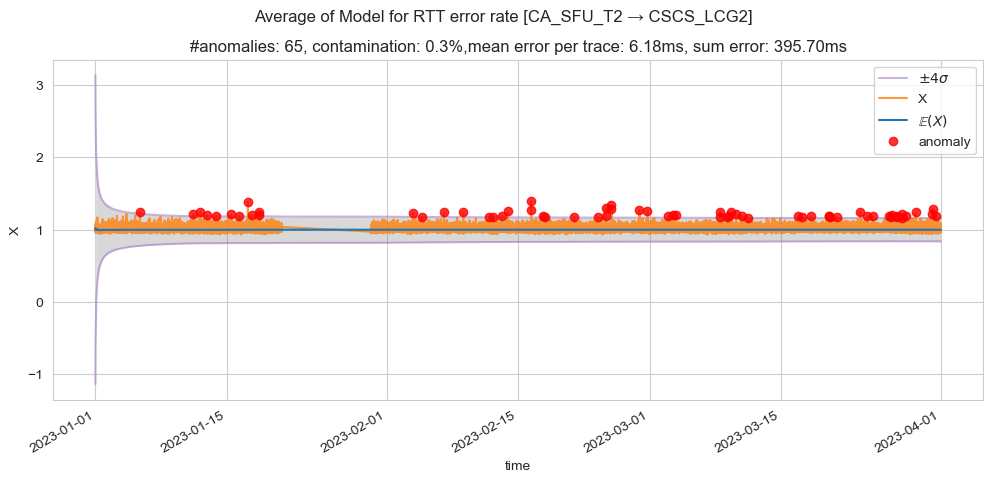

In [59]:
fig= plt.figure(figsize=(12, 5))
ax = plt.gca()
model.plot(ax = ax)
fig.suptitle(f"Average of Model for RTT error rate [{src_site} → {dest_site}]");
ax.set_title(f"#anomalies: {model.n_anomalies}, contamination: {100*model.n_anomalies/model.n:.1f}%," 
f"mean error per trace: {df[model.to_frame().anomalies]['sum_rtt_error'].mean():.2f}ms, "
f"sum error: {df[model.to_frame().anomalies]['sum_rtt_error'].sum():.2f}ms")
plt.show()

### Mean of weights

In [56]:

model = NormalModel('a', 'b', one_sided=True, sigma_factor = 4, mu_0=0, sigma_0=0.1, alpha_0=5, beta_0=1, gamma=1, )
for i, x in rtt_anom_df['mix'].items():
    model.log(i.timestamp()*1000, x)

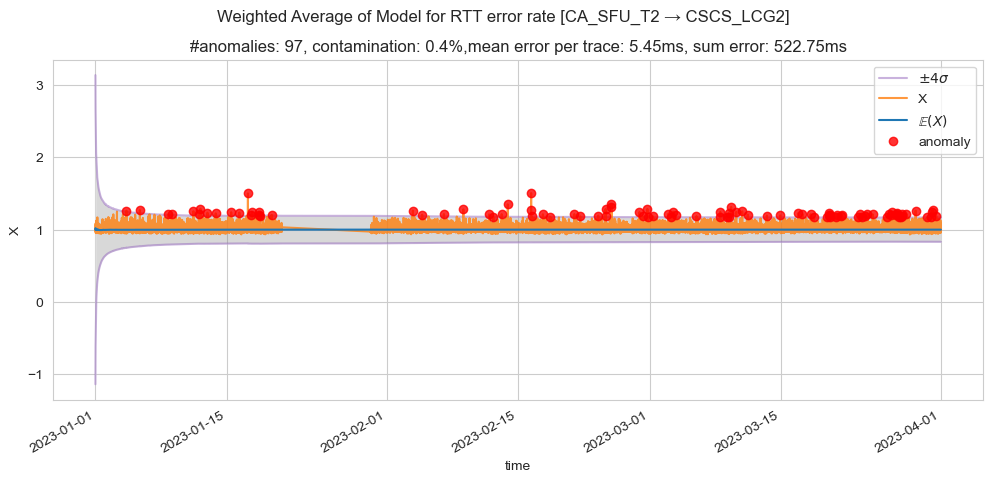

In [57]:
fig= plt.figure(figsize=(12, 5))
ax = plt.gca()
model.plot(ax = ax)
fig.suptitle(f"Weighted Average of Model for RTT error rate [{src_site} → {dest_site}]");
ax.set_title(f"#anomalies: {model.n_anomalies}, contamination: {100*model.n_anomalies/model.n:.1f}%," 
f"mean error per trace: {df[model.to_frame().anomalies]['sum_rtt_error'].mean():.2f}ms, "
f"sum error: {df[model.to_frame().anomalies]['sum_rtt_error'].sum():.2f}ms")
plt.show()

### Harmonic Mean of weights

In [60]:
model = NormalModel('a', 'b', one_sided=True, sigma_factor = 4, mu_0=0, sigma_0=0.1, alpha_0=5, beta_0=1, gamma=1, )
for i, x in rtt_anom_df['hmix'].items():
    model.log(i.timestamp()*1000, x)

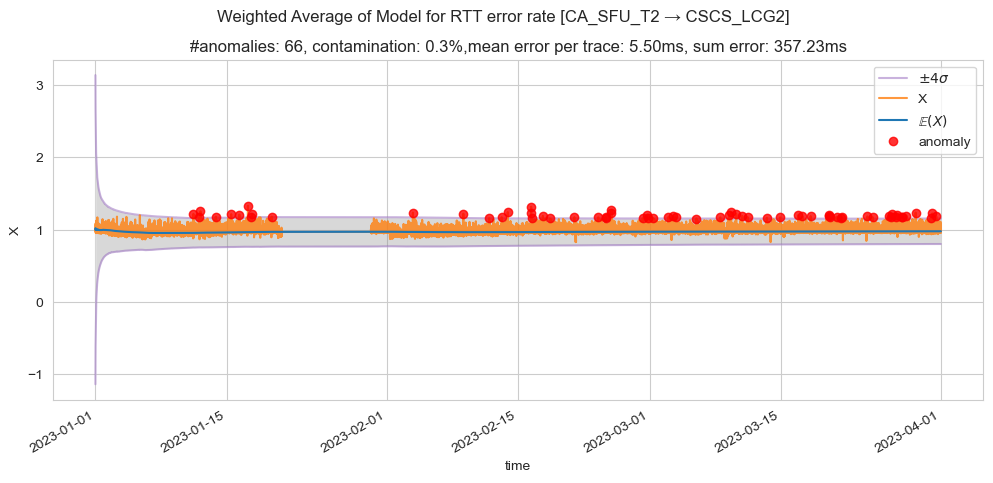

In [61]:
fig= plt.figure(figsize=(12, 5))
ax = plt.gca()
model.plot(ax = ax)
fig.suptitle(f"Weighted Average of Model for RTT error rate [{src_site} → {dest_site}]");
ax.set_title(f"#anomalies: {model.n_anomalies}, contamination: {100*model.n_anomalies/model.n:.1f}%," 
f"mean error per trace: {df[model.to_frame().anomalies]['sum_rtt_error'].mean():.2f}ms, "
f"sum error: {df[model.to_frame().anomalies]['sum_rtt_error'].sum():.2f}ms")
plt.show()

In [24]:
tmp = model.to_frame()[['observed', 'anomalies']]

In [25]:
tmp['anoms'] = np.nan
tmp.loc[tmp['anomalies'],'anoms']=tmp.loc[tmp['anomalies']]['observed']

In [26]:
df['sum_rtt_error'] = df['rtt_error_diff'].apply(np.sum)

## interactive plot with real errors 

In [27]:
import plotly.graph_objects as go

In [28]:
fig = go.Figure(data=[
    go.Scatter(x=tmp.index, y=tmp.observed, mode='lines', customdata=df['sum_rtt_error'], name="RTT error"),
    go.Scatter(x=tmp[tmp.anomalies].index, y=tmp[tmp.anomalies].observed, mode='markers', name="anomaly", customdata=df[tmp.anomalies]['sum_rtt_error'])],
    )
fig.update_traces(hovertemplate='Date:%{x}<br>value:%{y}<br>Time error:%{customdata:.2f}')

fig.update_layout(
    title=f"RTT errors on {dataset} [{'->'.join(list(stm.trace_models.keys())[ip_pair])}]<br>count:{df[tmp.anomalies].shape[0]}, mean:{df[tmp.anomalies]['sum_rtt_error'].mean():.2f}s, cumulative:{df[tmp.anomalies]['sum_rtt_error'].sum():.2f}s",
    xaxis_title="Date",
    yaxis_title="RTT error rate"
)

fig.show()

# TTL

I tried the same approach with TTL values

In [29]:
df['ttl_error_rate'] = df.apply(lambda row: calculate_error_rate(row['ttl_expected'], row['ttl_observed']), axis=1)
df['ttl_error_diff'] = df.apply(lambda row: calculate_error_difference(row['ttl_expected'], row['ttl_observed']), axis=1)

In [30]:
ttl_mean_z = []
ttl_anom_z = []
ttl_seq_z = []
ttl_hmix_z = []
ttl_mix_z = []

total_anoms = 1
index_cnt = defaultdict(lambda : 1)

for i, (ts, x) in tqdm(enumerate(df.iterrows()), total=df.shape[0]):
    anomalies = np.array(x['ttl_anoms'])
    
    anom_w = np.array(x['ttl_n_anoms'])
    anom_w = np.log1p(anom_w+1).astype(np.float64)
    anom_w /= anom_w.sum()

    uniform_w = np.ones(anomalies.shape[0])
    uniform_w /= np.sum(uniform_w)

    seq_w = calculate_seq_weights(anomalies)
    seq_w /= np.sum(seq_w)

    v = np.array(x['ttl_error_rate'])
    ttl_mean_z.append(v.mean())
    ttl_anom_z.append(v @ anom_w.T)
    ttl_seq_z.append(v @ seq_w.T)
    ttl_hmix_z.append(v @ hmean([uniform_w, anom_w, seq_w], axis=0).T)
    ttl_mix_z.append(v @ np.mean([uniform_w, anom_w, seq_w], axis=0).T)

100%|██████████| 22185/22185 [00:17<00:00, 1294.25it/s]


In [31]:
ttl_anom_df = pd.DataFrame(data=list(zip(ttl_mean_z, ttl_anom_z, ttl_seq_z ,ttl_hmix_z, ttl_mix_z)), index=df.index, columns=['mean', 'anom', 'seq', 'hmix', 'mix'])

In [32]:
ttl_anom_df.plot(backend='plotly',  title='TTL error rates')

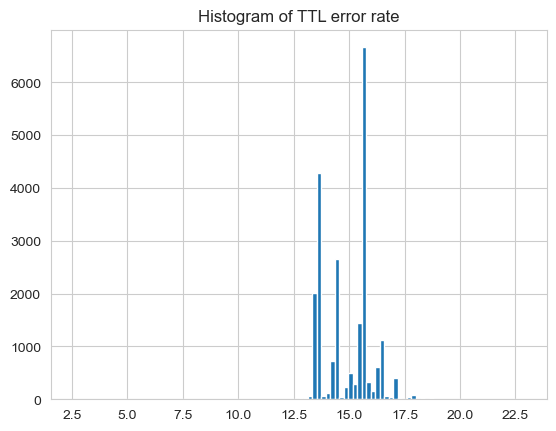

In [33]:
ax = df['ttl_error_rate'].apply(np.sum).hist(bins=100)
ax.set_title('Histogram of TTL error rate');

In [70]:
model = NormalModel('a', 'b', one_sided=True, sigma_factor = 4, mu_0=0, sigma_0=0.1, alpha_0=5, beta_0=1, gamma=1, )
for i, x in ttl_anom_df['hmix'].items():
    model.log(i.timestamp()*1000, x)

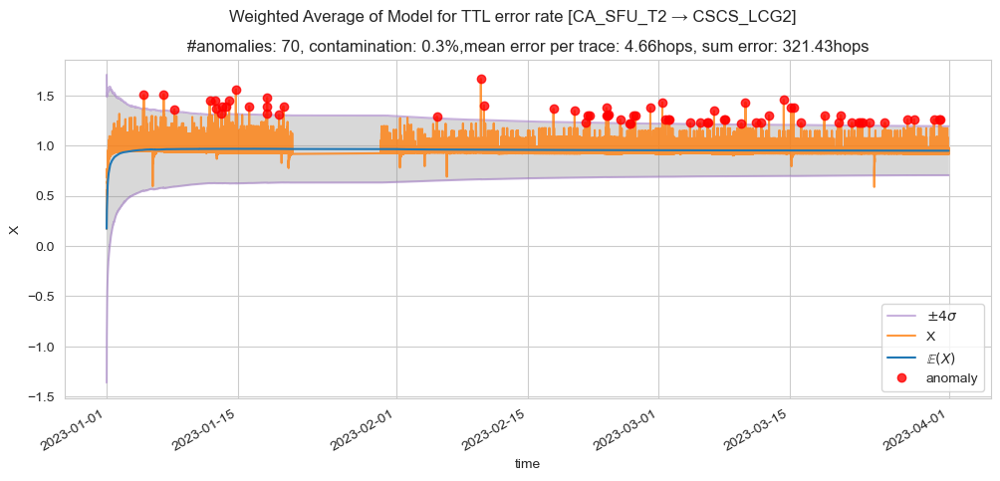

In [71]:
fig= plt.figure(figsize=(12, 5))
ax = plt.gca()
model.plot(ax = ax)
fig.suptitle(f"Weighted Average of Model for TTL error rate [{src_site} → {dest_site}]");
ax.set_title(f"#anomalies: {model.n_anomalies}, contamination: {100*model.n_anomalies/model.n:.1f}%," 
f"mean error per trace: {df[model.to_frame().anomalies]['ttl_error_diff'].apply(np.sum).mean():.2f}hops, "
f"sum error: {df[model.to_frame().anomalies]['ttl_error_diff'].apply(np.sum).sum():.2f}hops"
)
plt.show()

Text(0.5, 1.0, 'Histogram of TTL errors for detected records')

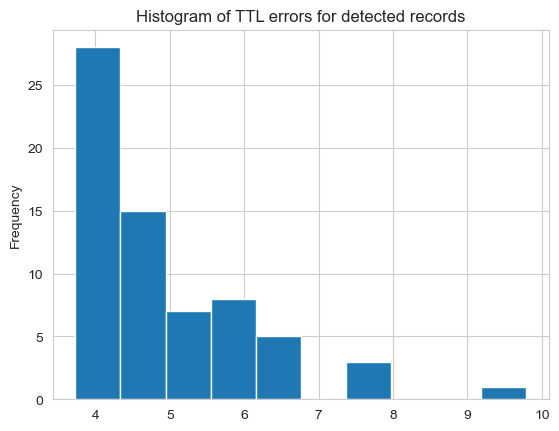

In [36]:
ax = df.loc[model.to_frame()['anomalies']]['ttl_error_diff'].apply(lambda x:np.sum(np.abs(x))).plot(kind='hist')
ax.set_title('Histogram of TTL errors for detected records')

In [37]:
tmp = model.to_frame()[['observed', 'anomalies']]
tmp['anoms'] = np.nan
tmp.loc[tmp['anomalies'],'anoms']=tmp.loc[tmp['anomalies']]['observed']
df['ttl_error'] = df['ttl_error_diff'].apply(lambda x:np.sum(np.abs(x)))

### Interactive plot

In [38]:
fig = go.Figure(
    data=[
        go.Scatter(x=tmp.index, y=tmp.observed, mode='lines', customdata=df['ttl_error'], name="TTL error"),
        go.Scatter(x=tmp[tmp.anomalies].index, y=tmp[tmp.anomalies].observed, mode='markers', name="anomaly", customdata=df[tmp.anomalies]['ttl_error'])]
)

fig.update_traces(hovertemplate='Date:%{x}<br>value:%{y}<br>Hops error:%{customdata:.2f}')

fig.update_layout(
    title=f"TTL errors on {dataset} [{'->'.join(list(stm.trace_models.keys())[ip_pair])}] <br>count:{df[tmp.anomalies].shape[0]}, mean: {df[tmp.anomalies]['ttl_error'].mean():.2f} hops, cumulative: {df[tmp.anomalies]['ttl_error'].sum():.2f} hops",
    xaxis_title="Date",
    yaxis_title="TTL error rate",
)

fig.show()

<Axes: xlabel='ts'>

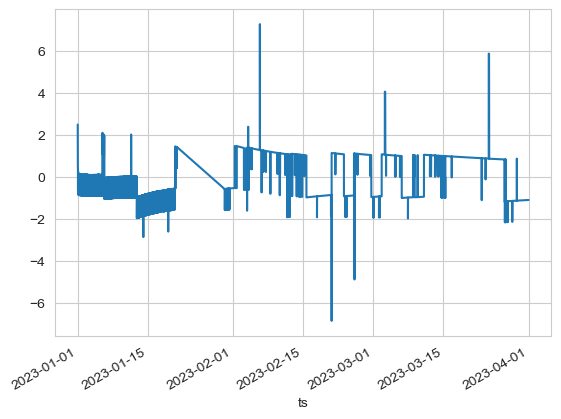

In [39]:
(df['n_hops_observed']-df['n_hops_expected']).plot()

In [40]:
for i, x in df.groupby(by=['path_hash']):

    if x.shape[0] <= 1:
        continue

    display(x['asn_probs'].apply(np.mean).sort_index().plot( backend='plotly'))
    if i=="dd1e6b3bea85b90ad53e87c80269963fa24b08a7":
        break

In [41]:
x['path_prob']

ts
2023-01-05 23:35:56    0.000552
2023-01-05 23:46:50    0.000826
2023-01-06 01:04:58    0.001078
2023-01-06 01:38:09    0.001336
2023-01-06 02:17:36    0.001584
2023-01-06 02:46:14    0.001836
2023-01-06 03:06:33    0.002085
2023-01-06 04:26:57    0.002307
2023-01-06 04:34:39    0.002556
2023-01-06 05:57:58    0.002756
Name: path_prob, dtype: float64

In [42]:
tmp

,observed,anomalies,anoms
2023-01-01 00:03:53,0.171349,False,NaN
2023-01-01 00:06:10,0.211247,False,NaN
2023-01-01 00:14:52,0.262306,False,NaN
2023-01-01 00:16:02,0.365656,False,NaN
2023-01-01 00:24:56,0.390508,False,NaN
...,...,...,...
2023-03-31 23:37:24,0.982719,False,NaN
2023-03-31 23:43:53,0.912979,False,NaN
2023-03-31 23:45:44,0.912980,False,NaN
2023-03-31 23:53:16,0.912981,False,NaN


<Axes: xlabel='ts'>

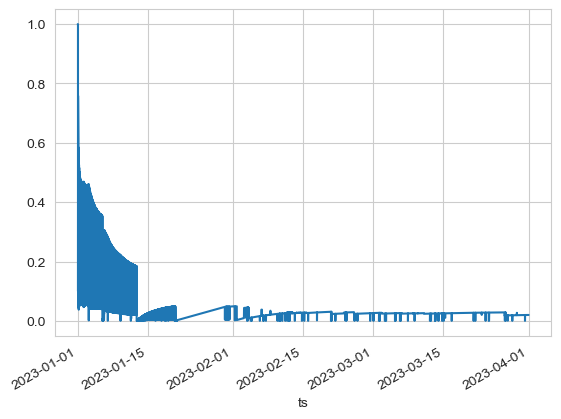

In [43]:
df['path_prob'].plot()

<Axes: xlabel='ts'>

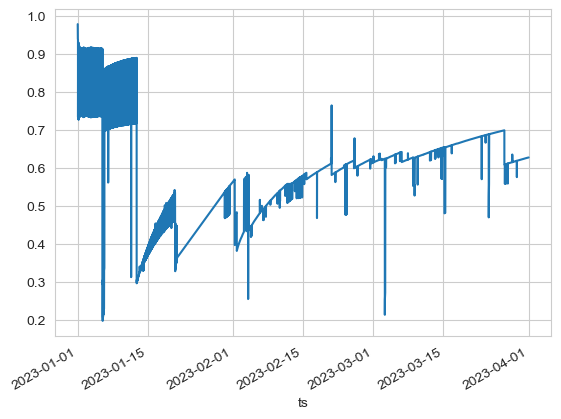

In [44]:
((df['ip_probs'].apply(np.mean))).plot()

<Axes: xlabel='ts'>

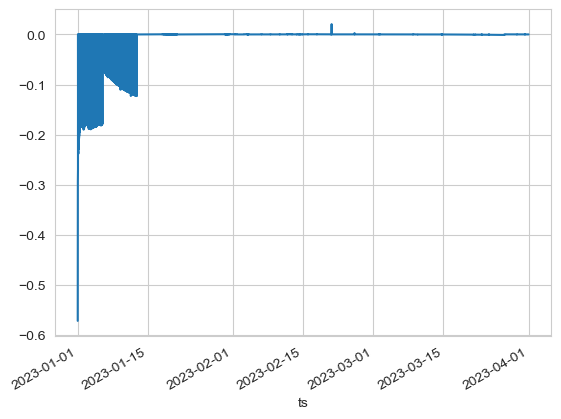

In [45]:

(df['asn_probs'].apply(np.prod)-df['ip_probs'].apply(np.prod)).plot()

In [46]:
# fig = plt.figure()
# df['n_hops_prob'].iloc[1:].plot(ax=plt.gca())
# df[df['unique_asns'] != df['unique_asns'].shift(1)].iloc[1:]['n_hops_prob'].plot(style='o', ax=plt.gca())